In [29]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [30]:
import pandas as pd
df = pd.read_csv('/content/drive/My Drive/PMLDL /city.csv')
del df['postal_code']
del df['capital_marker']
del df['kladr_id']
del df['fias_id']
del df['foundation_year']
del df['okato']
del df['settlement']
del df['country']
del df['federal_district']
del df['settlement_type']
del df['oktmo']
del df['tax_office']
del df['timezone']
del df['city']
del df['region']
del df['area']
del df['region_type']
del df['city_type']
del df['area_type']
del df['fias_level']

print(df.columns)

Index(['address', 'geo_lat', 'geo_lon', 'population'], dtype='object')


In [31]:
dataTypeSeries = df.dtypes
print('Data type of each column of Dataframe :')
print(dataTypeSeries)

Data type of each column of Dataframe :
address        object
geo_lat       float64
geo_lon       float64
population     object
dtype: object


In [0]:
df["population"] = pd.to_numeric(df["population"], errors='coerce')
df["population"] = df['population'].astype(str).astype(float)
df = df.sort_values(by='population', ascending=False)

In [0]:
df = df.head(n=30)

In [34]:
dataTypeSeries = df.dtypes
print('Data type of each column of Dataframe :')
print(dataTypeSeries)

Data type of each column of Dataframe :
address        object
geo_lat       float64
geo_lon       float64
population    float64
dtype: object


In [0]:
myCitiesName = df['address'].values
myCitiesLat = df['geo_lat'].values
myCitiesLon = df['geo_lon'].values

In [0]:
cities = []
for i in range(len(myCitiesName)):
    cities.append((myCitiesName[i],(myCitiesLat[i], myCitiesLon[i]) ))

In [37]:
print(cities)

[('г Москва', (55.7540471, 37.620405)), ('г Санкт-Петербург', (59.9391313, 30.315900399999997)), ('г Новосибирск', (55.02819100000001, 82.9211489)), ('г Екатеринбург', (56.8385216, 60.605491099999995)), ('г Нижний Новгород', (56.3240627, 44.00539129999999)), ('г Казань', (55.7943584, 49.1114975)), ('г Самара', (53.195030599999996, 50.1069518)), ('г Омск', (54.9848566, 73.3674517)), ('г Челябинск', (55.16026239999999, 61.400807799999995)), ('г Ростов-на-Дону', (47.2224566, 39.718803)), ('г Уфа', (54.73494399999999, 55.9578468)), ('г Волгоград', (48.7070042, 44.5170339)), ('г Пермь', (58.0102583, 56.2342034)), ('г Красноярск', (56.00938789999999, 92.85248059999999)), ('г Воронеж', (51.659333200000006, 39.1969229)), ('г Саратов', (51.5303047, 45.9529348)), ('г Краснодар', (45.0401604, 38.975964700000006)), ('Самарская обл, г Тольятти', (53.5205348, 49.3894028)), ('г Барнаул', (53.3479968, 83.7798064)), ('г Ижевск', (56.852738, 53.21148960000001)), ('г Ульяновск', (54.307941500000005, 48.3

In [38]:
BBox = (df.geo_lon.min(), df.geo_lon.max(),df.geo_lat.min(), df.geo_lat.max())
print(BBox)

(30.315900399999997, 135.05989419999997, 42.9849159, 59.9391313)


(42.9849159, 59.9391313)

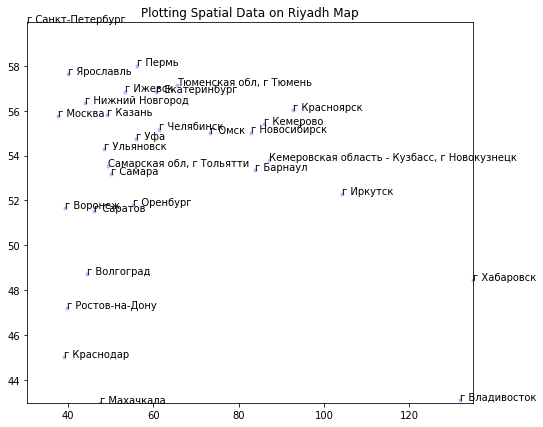

In [39]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize = (8,7))
ax.scatter(df.geo_lon, df.geo_lat, zorder=1, alpha= 0.2, c='b', s=10)
for i, txt in enumerate(df.address):
    ax.annotate(txt, (myCitiesLon[i], myCitiesLat[i]))
ax.set_title('Plotting Spatial Data on Riyadh Map')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])

In [0]:
from math import sin, cos, sqrt, atan2, radians
def find_distance(city1, city2):
    lat1 = radians(city1[1][0])
    lon1 = radians(city1[1][1])
    lat2 = radians(city2[1][0])
    lon2 = radians(city2[1][1])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    R = 6373.0 # approximate radius of earth in km
    distance = R * c
    return distance
def swap_random(seq):
     idx = range(len(seq))
     i1, i2 = random.sample(idx, 2)
     seq[i1], seq[i2] = seq[i2], seq[i1]

In [0]:
import random

path = []
for i in range(len(cities)):
  path.append(i)
random.shuffle(path)

In [0]:
def next_state(previous_path):
  swap_random(previous_path)

def count_path(path):
  distance = 0
  for i in range(len(path) - 1):
    distance += find_distance(cities[path[i]], cities[path[i+1]])
  return distance

def p(path_count, T):
  return np.exp(-1 * path_count/T)

In [0]:
import numpy as np
T = 100
distances = []
while(T>0):
  old_energy = count_path(path)
  old_path = path.copy()
  next_state(path)
  new_energy = count_path(path)
  if(new_energy>old_energy):
      alpha = p(new_energy,T)/p(old_energy,T)
      s = np.random.uniform(0,1)
      if(s>alpha):
          path = old_path
  distances.append(count_path(path))
  print(count_path(path))
  T *= 0.9

61658.87460213553
61658.87460213553
62789.32990123759
62776.52889784251
62332.672262123146
65759.26658265009
61826.599739176585
60270.323217776335
62275.202515415935
62244.90584357736
61751.688690204464
59255.328615845814
59654.53047076772
59540.65029040238
63473.317133875884
63460.0381116842
62949.701342628425
63017.092739065745
64329.509646757826
64298.61267801927
64645.897201487474
65570.9742738885
65469.76076492094
65820.44857450567
65767.46545105556
65670.01791073817
65795.73000721163
68768.16460827512
67478.35503731975
66972.53616220206
66945.66242528585
67157.07715623682
67071.76013896754
65572.49751956268
65303.02199670308
65319.005189642274
69364.54347079992
64040.13780741454
63442.403283454136
63465.509446423355
63464.063891958205
63443.914875680035
61768.1527426275
62168.99649232852
62376.99487166938
61906.86087941272
62824.13382653774
62815.31504362712
58673.00800953144
61197.72858984326
63349.95509631949
63819.05681214228
65274.964260865156
64224.34462215003
64458.83515533

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.



62463.04027130752
62844.64639074923
58986.496957031064
57805.0326097818
63156.72689915448
63110.745851519554
59649.49341699166
61226.667768632
61926.32969549237
57711.043340199736
63289.10686862667
68732.19927948587
69374.24182143463
69644.72378661796
69608.35348189287
69525.91610179337
63847.072277262785
63499.40777231586
62375.86246147161
62467.046551080646
63136.02112554435
63195.02888218524
63257.45848539372
61740.93752021745
64541.655168790785
67931.32126344404
68024.59138284571
69106.4256520857
69361.93219608993
68888.41681699552
69065.98330859345
64801.858377815275
66212.60435675352
62894.81480164688
62765.06047866243
63320.894160415075
64273.325511989235
67532.2152830037
67279.57446439272
67288.61864656063
67418.67290872274
67520.44773544579
64883.19524946475
63738.685052253284
63859.57070828022
65182.921301565504
67059.94227062918
66507.54189930142
66480.2396023119
67856.19460682412
65669.64570894137
65492.24004344468
64116.28503893247
62916.63574935922
62905.06813219968
6269

In [0]:
plt.plot(distances)
plt.show()